In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# for vizualizations
%matplotlib inline 
import matplotlib.pyplot as plt
from matplotlib import cm as cm
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
sns.set()
from sklearn.utils import shuffle

In [2]:
data = pd.read_csv('songs.csv')
data = data.drop(['filename'],axis = 1)
data.head()

,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,flatness,poly,chroma_cqt,chroma_cens,...,mfcc18,mfcc19,mfcc20,tonnetz1,tonnetz2,tonnetz3,tonnetz4,tonnetz5,tonnetz6,label
0,0.257259,0.09198,1195.411640,1481.284259,2234.878153,0.058871,0.017725,1.086251,0.555419,0.268175,...,-1.337586,-3.719717,-4.353154,0.020575,0.016943,0.088439,-0.026695,0.012183,-0.005494,blues
1,0.412501,0.09198,2171.221742,1954.383785,4237.132712,0.132802,0.000642,0.594293,0.513369,0.267898,...,-0.271427,-3.696092,-0.504041,-0.002745,0.008571,-0.042509,0.057754,0.005468,0.017238,blues
2,0.379428,0.09198,2148.786199,2204.574064,4673.663406,0.098812,0.005946,1.750953,0.594625,0.274696,...,0.464257,-1.909089,-3.128308,-0.010565,0.000952,0.003099,0.026811,-0.004230,0.006860,blues
3,0.340983,0.09198,1529.835316,2038.617579,3548.820207,0.056044,0.005735,1.223702,0.509443,0.267173,...,0.293875,-0.287431,0.531573,-0.020591,0.000802,0.031767,-0.016651,0.005038,0.005216,blues
4,0.356588,0.09198,2068.371125,2033.930047,4231.499413,0.104372,0.002294,0.675315,0.503215,0.261366,...,0.194597,0.842872,-3.416576,0.007437,0.018288,0.046516,0.011819,0.007859,-0.007299,blues


Shuffling dataset to ensure that it is not unbalance.

In [4]:
data = shuffle(data)

In [5]:
data.shape

(1000, 38)

In [6]:
data.dtypes

chroma_stft           float64
rmse                  float64
spectral_centroid     float64
spectral_bandwidth    float64
rolloff               float64
zero_crossing_rate    float64
flatness              float64
poly                  float64
chroma_cqt            float64
chroma_cens           float64
spectral_contrast     float64
mfcc1                 float64
mfcc2                 float64
mfcc3                 float64
mfcc4                 float64
mfcc5                 float64
mfcc6                 float64
mfcc7                 float64
mfcc8                 float64
mfcc9                 float64
mfcc10                float64
mfcc11                float64
mfcc12                float64
mfcc13                float64
mfcc14                float64
mfcc15                float64
mfcc16                float64
mfcc17                float64
mfcc18                float64
mfcc19                float64
mfcc20                float64
tonnetz1              float64
tonnetz2              float64
tonnetz3  

# Data description

Chroma_stft: Chroma features are an interesting and powerful representation for music audio in which the entire spectrum is projected onto 12 bins representing the 12 distinct semitones (or chroma) of the musical octave.
Chroma representations measure the amount of relative energy in each pitch class (e.g., the 12 notes in the chromatic scale) at a given frame/time.

Spectral flatness (or tonality coefficient) is a measure to quantify how much noise-like a sound is, as opposed to being tone-like [1]. A high spectral flatness (closer to 1.0) indicates the spectrum is similar to white noise.

Spectral centroid is a measure used in digital signal processing to characterise a spectrum. It indicates where the "center of mass" of the spectrum is located.

Spectral_bandwidth is the Wavelength interval in which a radiated spectral quantity is not less than half its maximum value.

Spectral Rolloff: This is a measure measure of the amount of the right-skewedness of the power spectrum.
The spectral rolloff point is the fraction of bins in the power spectrum at which 85% of the power is at lower frequencies.

Zero Crossings: This is a good measure of the pitch as well as the noisiness of a signal. Zero crossings are calculated by finding the number of times the signal changes sign from one sample to another (or touches the zero axis)

Chroma_cqt: The constant-Q transform transforms a data series to the frequency domain. It is related to the Fourier transform and very closely related to the complex Morlet wavelet transform.
The transform can be thought of as a series of logarithmically spaced filters fk, with the k-th filter having a spectral width equal to a multiple of the previous filter's width.

Chroma energy normalized statistics (CENS). The main idea of CENS features is that taking statistics over large windows smooths local deviations in tempo, articulation, and musical ornaments such as trills and arpeggiated chords. CENS are best used for tasks such as audio matching and similarity

Poly_features: Get coefficients of fitting an nth-order polynomial to the columns of a spectrogram.

Spectral contrast is distributions of sound energy over octave frequencies

Mel-frequency cepstral coefficients (MFCC): the coefficients that collectively make up the short-term power spectrum of a sound

Tonnetz estimates tonal centroids as coordinates in a six-dimensional interval space

Label: genres of audio file

In [8]:
data.describe()

,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,flatness,poly,chroma_cqt,chroma_cens,...,mfcc17,mfcc18,mfcc19,mfcc20,tonnetz1,tonnetz2,tonnetz3,tonnetz4,tonnetz5,tonnetz6
count,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.378669,0.09198,2201.834226,2242.559613,4571.702159,0.103637,0.021566,1.247247,0.498760,0.256990,...,-3.967431,0.507303,-2.328779,-1.094875,0.004033,0.005490,0.000082,0.007172,0.000980,0.000416
std,0.081706,0.00000,715.961347,526.337663,1574.770035,0.041834,0.028873,0.795860,0.068596,0.016593,...,4.550650,3.869088,3.755574,3.837561,0.016083,0.015797,0.041942,0.043174,0.007666,0.008455
min,0.171782,0.09198,569.930721,897.994319,749.062137,0.021701,0.000092,0.028909,0.302399,0.189776,...,-17.227765,-11.975698,-18.504188,-19.935203,-0.040474,-0.056324,-0.192949,-0.191379,-0.039443,-0.029400
25%,0.319641,0.09198,1627.793931,1907.136505,3380.956639,0.070281,0.003126,0.642479,0.450065,0.247063,...,-7.194297,-2.003979,-4.670281,-3.368000,-0.006953,-0.004397,-0.024825,-0.019877,-0.003250,-0.004498
50%,0.383075,0.09198,2209.468780,2221.408983,4658.671830,0.099539,0.010030,1.123182,0.502476,0.260974,...,-4.059109,0.669788,-2.391261,-1.155198,0.004904,0.005170,0.003128,0.008506,0.001497,0.000584
75%,0.435974,0.09198,2691.969702,2578.474352,5534.197785,0.132007,0.030948,1.693854,0.547666,0.269706,...,-0.842968,3.112518,0.149070,1.303739,0.015462,0.015972,0.027653,0.034557,0.005565,0.005668
max,0.663573,0.09198,4434.439444,3509.578677,8676.405868,0.274829,0.417907,7.555511,0.691526,0.284715,...,11.489994,15.379257,14.686910,15.368966,0.055005,0.056947,0.133945,0.170869,0.027190,0.030072


In [9]:
data.drop(['rmse'],axis = 1)

,chroma_stft,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,flatness,poly,chroma_cqt,chroma_cens,spectral_contrast,...,mfcc18,mfcc19,mfcc20,tonnetz1,tonnetz2,tonnetz3,tonnetz4,tonnetz5,tonnetz6,label
442,0.437988,1818.873827,2521.747131,3999.867480,0.051363,0.007156,1.516022,0.526924,0.262911,20.605307,...,-1.310101,-4.241651,-5.002868,-0.012077,0.005386,-0.048508,-0.067821,0.018922,-0.011805,hiphop
330,0.485345,2574.792403,2396.775584,5459.475321,0.146169,0.118352,2.440433,0.581608,0.275620,17.080270,...,5.796770,-3.498463,-0.049957,0.004892,0.011849,0.016705,-0.024294,0.004207,-0.005241,disco
121,0.215813,2172.340941,1883.258566,4066.550410,0.151986,0.009635,0.128379,0.456915,0.245207,20.529359,...,9.201811,2.801201,-5.379816,0.002445,0.030602,0.017286,-0.010852,0.001965,-0.000371,classical
383,0.434281,2902.964737,2302.277890,5470.533587,0.184139,0.044976,1.864918,0.571364,0.272507,19.211660,...,7.250276,-2.669735,6.573678,0.003745,0.012992,-0.022381,0.037468,0.005503,0.008859,disco
354,0.414119,1959.458880,2210.825356,4352.890345,0.090033,0.005683,1.531665,0.543589,0.266302,20.537433,...,1.520714,-5.575977,-2.059116,0.009984,-0.004658,0.025835,-0.038960,-0.000243,0.004639,disco
219,0.421538,2898.717713,2878.981441,6399.852968,0.112936,0.000810,0.378285,0.338569,0.203602,23.652070,...,2.976282,-1.835009,-2.365688,0.015449,0.042066,-0.141420,0.088161,-0.010846,-0.012429,country
169,0.281670,1322.026416,1590.233329,2473.626709,0.076126,0.000633,0.224699,0.418586,0.234354,23.556037,...,-5.410751,-5.246985,-5.270150,0.022610,0.029358,0.048919,0.011160,0.000295,-0.002410,classical
831,0.449305,2454.135360,2820.835870,5582.107912,0.087577,0.003352,1.065735,0.427560,0.243356,18.593045,...,-0.933551,-0.944895,-3.531782,0.020093,-0.002122,0.059688,0.040510,0.010442,-0.003597,reggae
56,0.280714,1210.197917,1497.822809,2522.101416,0.052483,0.003934,2.094202,0.512429,0.265826,22.634071,...,-1.376940,7.550499,-3.032518,0.013736,0.019426,0.048519,0.014748,0.000813,0.001018,blues
451,0.443986,2095.284362,2240.775519,4581.080632,0.094187,0.009823,1.642528,0.472752,0.258119,18.413598,...,6.797163,-5.803967,-3.778690,-0.004328,-0.002507,-0.001389,-0.025807,0.009887,-0.005423,hiphop


In [13]:
print(data.groupby('label').size())

label
blues        100
classical    100
country      100
disco        100
hiphop       100
jazz         100
metal        100
pop          100
reggae       100
rock         100
dtype: int64


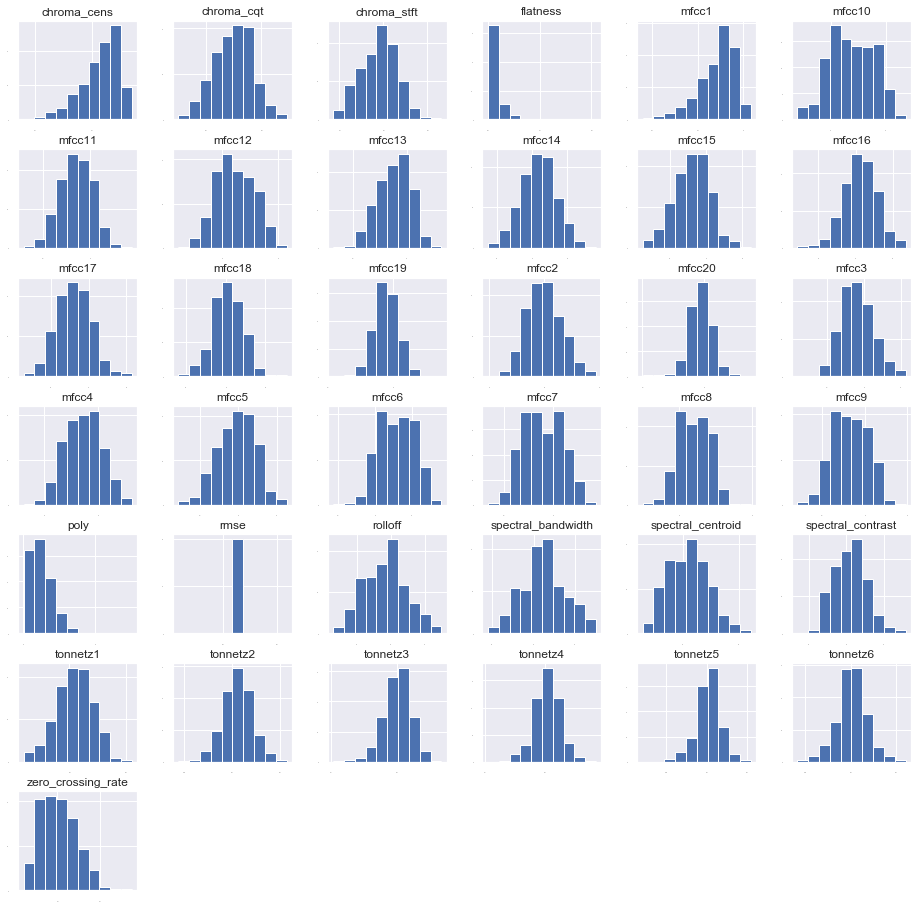

In [20]:
data.hist(sharex=False, sharey=False, xlabelsize=1, ylabelsize=1,figsize=(16,16))
plt.show()         

In [28]:
data.columns.tolist()

['chroma_stft',
 'rmse',
 'spectral_centroid',
 'spectral_bandwidth',
 'rolloff',
 'zero_crossing_rate',
 'flatness',
 'poly',
 'chroma_cqt',
 'chroma_cens',
 'spectral_contrast',
 'mfcc1',
 'mfcc2',
 'mfcc3',
 'mfcc4',
 'mfcc5',
 'mfcc6',
 'mfcc7',
 'mfcc8',
 'mfcc9',
 'mfcc10',
 'mfcc11',
 'mfcc12',
 'mfcc13',
 'mfcc14',
 'mfcc15',
 'mfcc16',
 'mfcc17',
 'mfcc18',
 'mfcc19',
 'mfcc20',
 'tonnetz1',
 'tonnetz2',
 'tonnetz3',
 'tonnetz4',
 'tonnetz5',
 'tonnetz6',
 'label']

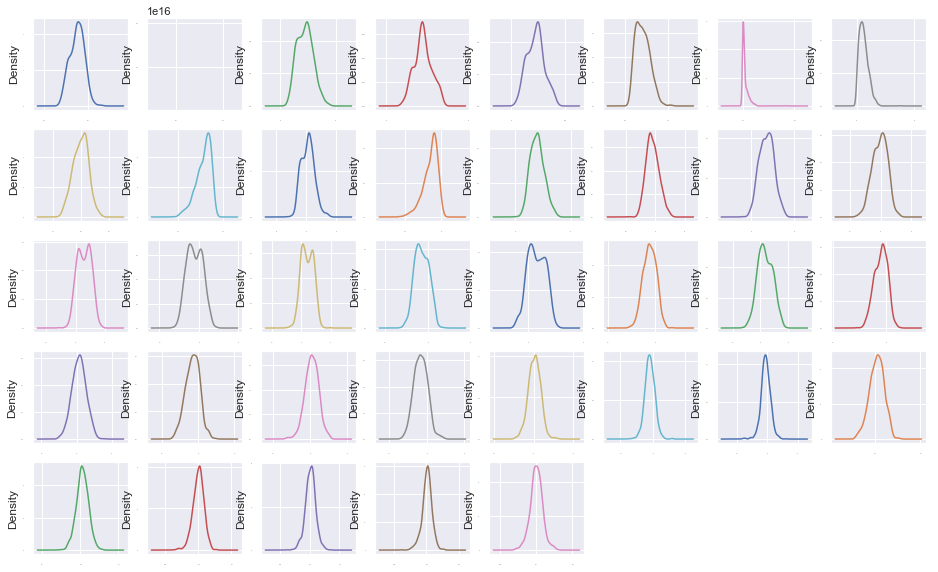

In [25]:
data.plot(kind='density', subplots=True, layout=(8,8), sharex=False, legend=False, fontsize=1,figsize=(16,16)) 
plt.show()

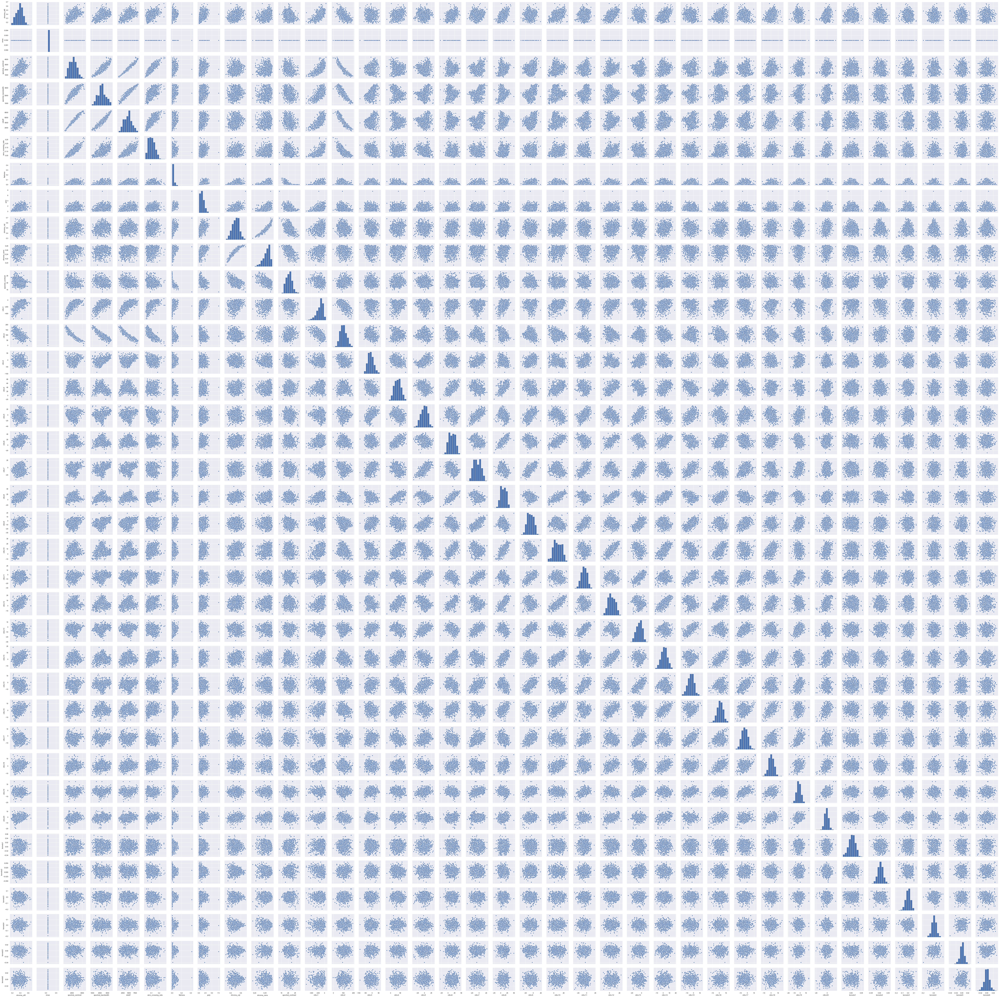

In [26]:
sns.pairplot(data)

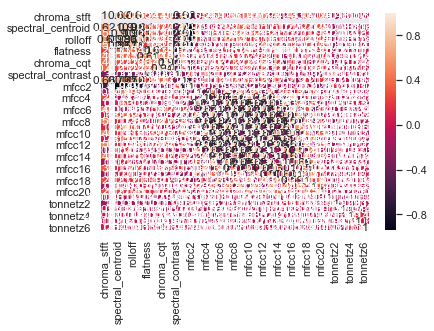

In [27]:
sns.heatmap(data.corr(),annot=True,vmax=1)

check whether mfcc features are correlated

In [29]:
mfcc_data = data[['mfcc1',
 'mfcc2',
 'mfcc3',
 'mfcc4',
 'mfcc5',
 'mfcc6',
 'mfcc7',
 'mfcc8',
 'mfcc9',
 'mfcc10',
 'mfcc11',
 'mfcc12',
 'mfcc13',
 'mfcc14',
 'mfcc15',
 'mfcc16',
 'mfcc17',
 'mfcc18',
 'mfcc19',
 'mfcc20']]

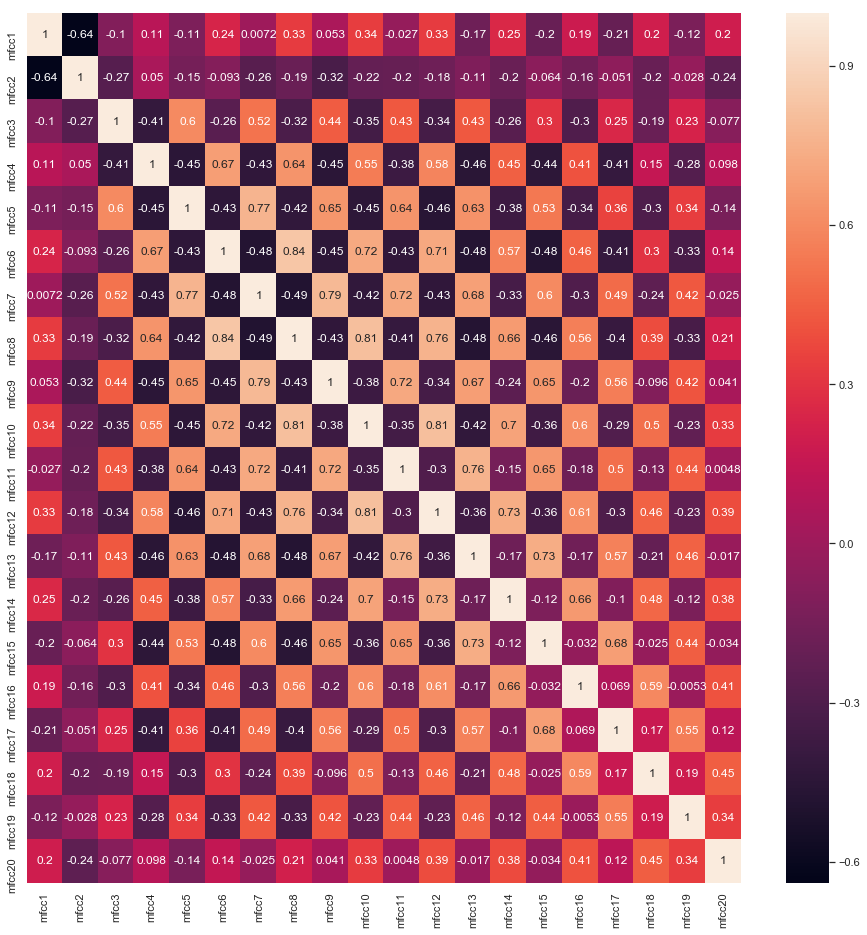

In [33]:
plt.figure(figsize = (16,16))
sns.heatmap(mfcc_data.corr(),annot=True,vmax=1)

This heat map above shows that mfcc features cover different information and not postively related.

investigating Tonnetz feature

In [35]:
tor_data = data[['tonnetz1',
 'tonnetz2',
 'tonnetz3',
 'tonnetz4',
 'tonnetz5',
 'tonnetz6']]

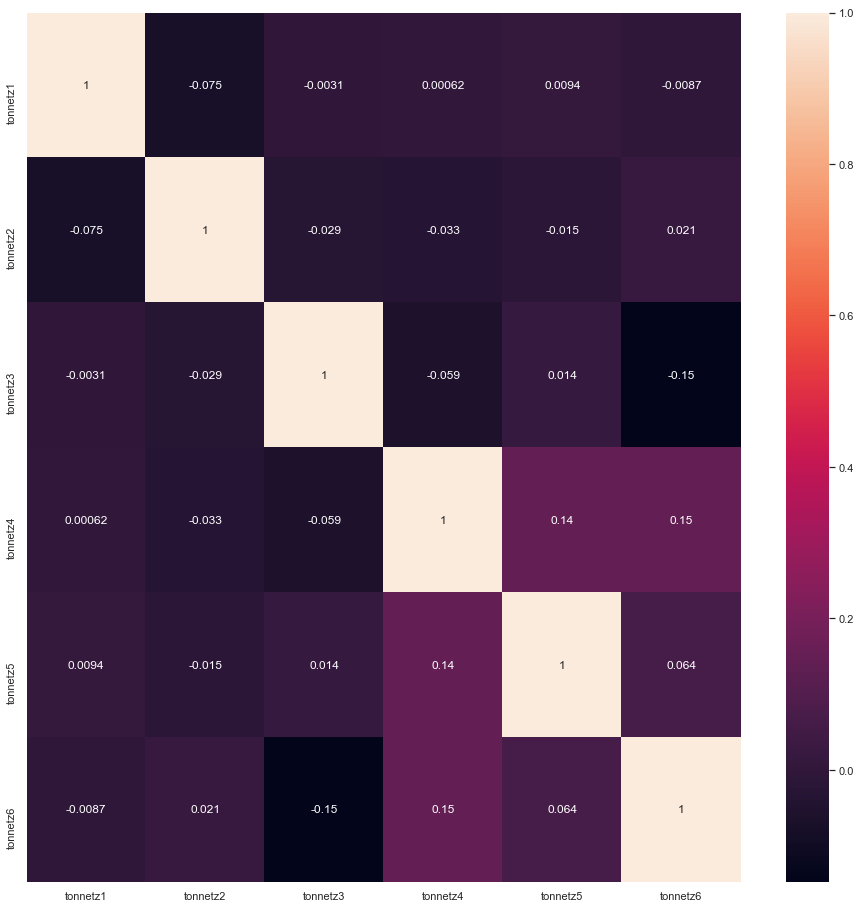

In [37]:
plt.figure(figsize = (16,16))
sns.heatmap(tor_data.corr(),annot=True,vmax=1)

We cnnot drop those features because they are not correlated with each other and thus each feature carry diffent information that is use to describe the audio file.